# Data Preparation

## Library

In [ ]:
%%capture
!pip install jcopml
!pip install category_encoders
!pip install imblearn

In [ ]:
import pandas as pd
import numpy as np

from scipy import stats
from scipy.stats import uniform, randint

import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster

from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.preprocessing import StandardScaler, OneHotEncoder, RobustScaler
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.utils import resample

from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, IsolationForest
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, make_scorer
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, KFold

## Load Data

In [ ]:
!gdown 1NJ7DsgZ3zIdZWTz17RQWgbtDBuk1JVg3

Downloading...
From: https://drive.google.com/uc?id=1NJ7DsgZ3zIdZWTz17RQWgbtDBuk1JVg3
To: /content/data_california_house.csv
100% 1.01M/1.01M [00:00<00:00, 46.7MB/s]


In [ ]:
df = pd.read_csv("data_california_house.csv")
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
0,-119.79,36.73,52.0,112.0,28.0,193.0,40.0,1.9750,INLAND,47500.0
1,-122.21,37.77,43.0,1017.0,328.0,836.0,277.0,2.2604,NEAR BAY,100000.0
2,-118.04,33.87,17.0,2358.0,396.0,1387.0,364.0,6.2990,<1H OCEAN,285800.0
3,-118.28,34.06,17.0,2518.0,1196.0,3051.0,1000.0,1.7199,<1H OCEAN,175000.0
4,-119.81,36.73,50.0,772.0,194.0,606.0,167.0,2.2206,INLAND,59200.0


| Fitur              | Deskripsi                                                                 |
|--------------------|---------------------------------------------------------------------------|
| **longitude**|  Ukuran seberapa jauh ke arah barat sebuah rumah di sebelah barat.                                                      |
| **latitude**| Ukuran seberapa jauh ke utara sebuah rumah.                                             |
| **housing_median_age**| Usia rata-rata sebuah rumah dalam satu blok; angka yang lebih rendah adalah bangunan yang lebih baru.                                          |
| **total_rooms**|  Jumlah total kamar tidur dalam satu blok.|
| **population**|  Jumlah total orang yang tinggal di dalam blok.                                        |
| **households**| Jumlah total rumah tangga, sekelompok orang yang tinggal di dalam satu unit rumah, untuk satu blok.                                           |
| **median_income**| Pendapatan rata-rata rumah tangga di dalam satu blok rumah (diukur dalam puluhan ribu Dolar AS).                                       |
| **ocean_proximity**| Lokasi rumah yang dekat dengan samudra/laut.                              |
| **median_house_value**|  Nilai rata-rata rumah untuk rumah tangga dalam satu blok (diukur dalam Dolar AS).           |




Penjelasan tentang isi dari kolom ocean_proximity.

| Isi Data              | Penjelasan                                                                 |
|--------------------|---------------------------------------------------------------------------|
| **ISLAND**|  Ini menunjukkan rumah tersebut terletak di sebuah pulau.                                                      |
| **<1H OCEAN**| Ini menandakan rumah tersebut berjarak kurang dari satu jam dari laut.                                             |
| **NEAR OCEAN**| Rumah tersebut lebih dekat dengan lautan ketimbang `<1H OCEAN.                                          |
| **NEAR BAY**|  Rumah tersebut berada di dekat teluk, yang merupakan perairan yang terhubung ke lautan atau danau.|
| **INLAND**|  Rumah tersebut tidak berada di dekat pantai, melainkan berada di pedalaman.                                        |

# Exploratory Data Analysis (EDA)

### Map Visualization

Menggunakan folium untuk memvisualisasikan data. Hal ini akan membantu  untuk memahami distribusi data berdasarkan lokasi data.

In [11]:
import folium
from folium.plugins import MarkerCluster

# Buat peta dasar tanpa pengaturan kompleks
housing_map = folium.Map(zoom_start=5)

# Tambahkan MarkerCluster
marker_cluster = MarkerCluster().add_to(housing_map)

# Tambahkan marker untuk setiap baris di dataframe
for _, row in df.iterrows():
    popup_info = (
        f"Age: {row['housing_median_age']}<br>"
        f"Rooms: {row['total_rooms']}<br>"
        f"Income: ${row['median_income']}<br>"
        f"Value: ${row['median_house_value']}<br>"
        f"Proximity: {row['ocean_proximity']}"
    )
    folium.Marker(
        [row['latitude'], row['longitude']],
        popup=popup_info,
        tooltip=f"${row['median_house_value']}"
    ).add_to(marker_cluster)

# Sesuaikan peta agar memuat semua marker
housing_map.fit_bounds([
    [df['latitude'].min(), df['longitude'].min()],
    [df['latitude'].max(), df['longitude'].max()]
])

# Tampilkan peta
housing_map

### Scatter Plot

Text(0.5, 1.0, 'California Ocean Proximity Group Location')

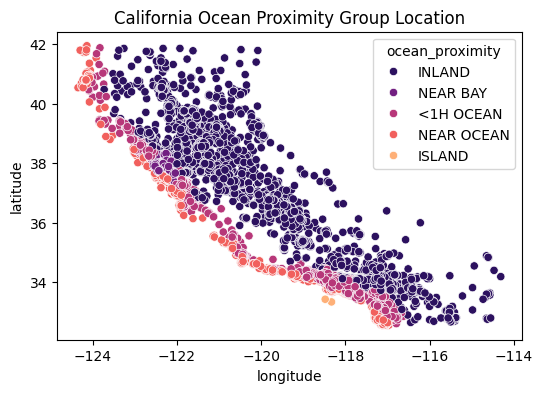

In [ ]:
# Ocean Proximity Plot
plt.figure(figsize=(6,4))
sns.scatterplot(data=df,
                x='longitude',
                y='latitude',
                hue='ocean_proximity',
                palette="magma").set_title('California Ocean Proximity Group Location')


Visualisasi seberapa dekat perumahan/blok dengan pantai. Terdapat kategori "ISLAND" (PULAU) dalam kolom ocean_proximity yang hanya memiliki dua data point/titik saja. Ini berarti dari seluruh perumahan/blok yang ada dalam dataset, hanya ada dua lokasi yang dikategorikan sebagai "ISLAND" atau terletak di pulau.

## Ocean Proximity Histogram

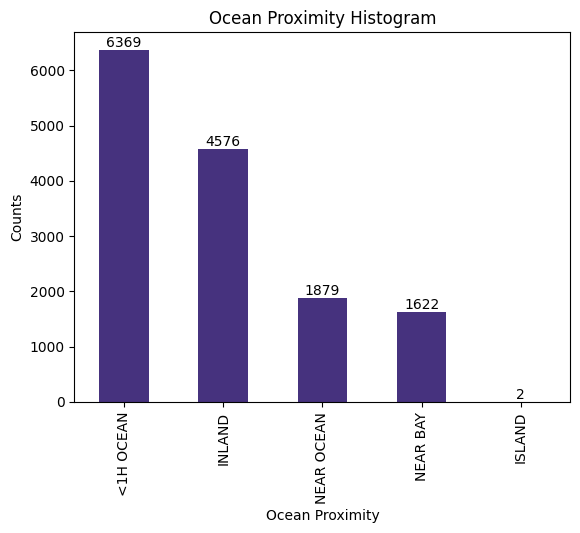

In [ ]:
# Set the color palette to viridis
sns.set_palette('viridis')

# Create the histogram
counts = df['ocean_proximity'].value_counts()
ax = counts.plot(kind='bar')

# Add value labels on top of each bar
for p in ax.patches:
    ax.annotate(f'{p.get_height()}',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='bottom')

plt.title('Ocean Proximity Histogram')
plt.xlabel('Ocean Proximity')
plt.ylabel('Counts')
plt.show()

Visualisasi histogram ini menunjukkan bahwa sebagian besar data dalam dataset perumahan memiliki lokasi dekat dengan pantai, sementara sangat sedikit (hanya 2) yang berada di lokasi pulau terpisah.

## Data Summary (Adding Quartile)

In [ ]:
  # Summary Function
def summarize_numerical_features(df):
    summary = {}
    for column in df.select_dtypes(include=[np.number]).columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1

        # Calculate lower and upper bounds
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Adjust lower bound for non-negative features
        if df[column].min() >= 0:  # Check if the feature is non-negative
            lower_bound = max(lower_bound, 0)  # Set lower bound to 0 if it's negative

        summary[column] = {
            'min': df[column].min(),
            'max': df[column].max(),
            'mean': df[column].mean(),
            'median': df[column].median(),
            'mode': df[column].mode()[0],
            'Q1': Q1,
            'Q2': df[column].quantile(0.5),
            'Q3': Q3,
            'lower_bound': lower_bound,
            'upper_bound': upper_bound
        }
    return pd.DataFrame(summary)

# Example usage
summary_df = summarize_numerical_features(df).T
summary_df


,min,max,mean,median,mode,Q1,Q2,Q3,lower_bound,upper_bound
longitude,-124.350000,-114.310000,-119.567150,-118.490000,-118.310,-121.800000,-118.490000,-118.000000,-127.500000,-112.300000
latitude,32.540000,41.950000,35.631365,34.260000,34.060,33.930000,34.260000,37.715000,28.252500,43.392500
housing_median_age,1.000000,52.000000,28.609671,29.000000,52.000,18.000000,29.000000,37.000000,0.000000,65.500000
total_rooms,2.000000,32627.000000,2640.917686,2125.000000,1582.000,1452.000000,2125.000000,3142.000000,0.000000,5677.000000
total_bedrooms,1.000000,6445.000000,538.260709,435.000000,331.000,295.000000,435.000000,647.000000,0.000000,1175.000000
population,3.000000,35682.000000,1424.772273,1164.000000,1227.000,784.000000,1164.000000,1722.000000,0.000000,3129.000000
households,1.000000,6082.000000,499.480470,410.000000,335.000,279.000000,410.000000,603.500000,0.000000,1090.250000
median_income,0.499900,15.000100,3.866774,3.540300,2.875,2.569400,3.540300,4.736100,0.000000,7.986150
median_house_value,14999.000000,500001.000000,206793.156942,180000.000000,500001.000,119400.000000,180000.000000,263750.000000,0.000000,480275.000000
rooms_per_household,0.846154,132.533333,5.425520,5.230769,5.000,4.453362,5.230769,6.047714,2.061834,8.439242


## Normality Test

In [ ]:
# Selecting numeric columns
numeric_cols = df.select_dtypes(include=['number']).columns

# Initialize a list to store results
results = []

# Loop through each numeric column to check for normality
for col in numeric_cols:
    shapiro_stat, shapiro_p = stats.shapiro(df[col])
    ks_stat, ks_p = stats.kstest(df[col], 'norm', args=(df[col].mean(), df[col].std()))
    dagostino_stat, dagostino_p = stats.normaltest(df[col])

    # Append results to the list with the feature name
    results.append({
        'Column': col,
        'Test Name': 'Shapiro-Wilk',
        'Normality': "Normal" if shapiro_p > 0.05 else "Tidak Normal"
    })
    results.append({
        'Column': col,
        'Test Name': 'Kolmogorov-Smirnov',
        'Normality': "Normal" if ks_p > 0.05 else "Tidak Normal"
    })
    results.append({
        'Column': col,
        'Test Name': 'D\'Agostino\'s K^2',
        'Normality': "Normal" if dagostino_p > 0.05 else "Tidak Normal"
    })

# Create Dataframe from the list
normality_result = pd.DataFrame(results)
normality_result = normality_result.pivot(index='Test Name', columns='Column', values='Normality')
normality_result

/usr/local/lib/python3.11/dist-packages/scipy/stats/_axis_nan_policy.py:586: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 14448.
  res = hypotest_fun_out(*samples, **kwds)


Column,households,housing_median_age,latitude,longitude,median_house_value,median_income,population,total_bedrooms,total_rooms
Test Name,,,,,,,,,
D'Agostino's K^2,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal
Kolmogorov-Smirnov,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal
Shapiro-Wilk,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal,Tidak Normal


Semua kolom numerik pada dataset, tidak terdistribusi dengan normal.

## Correlation


Uji Korelasi digunakan untuk menentukan apakah ada hubungan antara dua variabel. Di sini, kita akan menggunakan koefisien korelasi Spearman untuk mengukur korelasi antara setiap pasangan variabel karena data tidak terdistribusi secara normal.

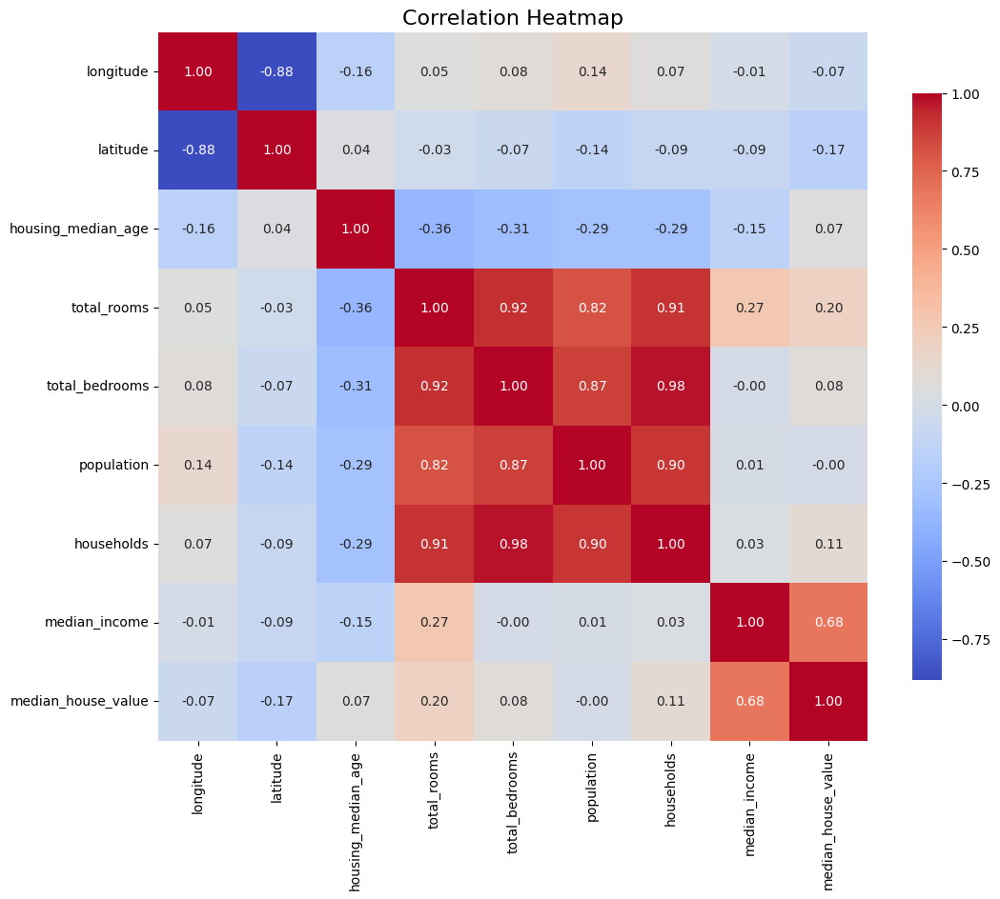

In [ ]:
# calculate correlation matrix
df_corr = df[numeric_cols].corr(method="spearman")

# display correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(df_corr, annot=True, fmt=".2f", cmap='coolwarm', square=True, cbar_kws={"shrink": .8})

plt.title('Correlation Heatmap', fontsize=16)
plt.show()

Temuan dari matriks korelasi diatas:

  
**Korelasi Positif yang Kuat**:  
   - `median_income` dan `median_house_value` (0,68): Pendapatan yang lebih tinggi berkorelasi dengan nilai rumah yang lebih tinggi.  
   - `total_rooms` dan `total_bedrooms` (0,91): Lebih banyak kamar berhubungan dengan lebih banyak kamar tidur.  
  
2. **Korelasi Positif Sedang**:  
   - `median_house_value` dan `total_rooms` (0,64): Lebih banyak kamar dapat menyebabkan nilai rumah yang lebih tinggi.  
   - `population` dan `households` (0.98): Lebih banyak populasi biasanya berarti lebih banyak rumah tangga.  
  
3. **Korelasi Negatif**:  
   - `housing_median_age` dan `median_house_value` (-0.17): Rumah yang lebih tua mungkin memiliki nilai yang lebih rendah.  
   - `bedrooms_ratio` dan `median_house_value` (-0.74): Rasio kamar tidur yang lebih tinggi terhadap total kamar berkorelasi dengan nilai rumah yang lebih rendah.  
  
4. **Korelasi Lemah**:  
   - `income_level` dan `median_house_value` (0,47): Hubungan positif yang moderat, menunjukkan tingkat pendapatan yang lebih tinggi mungkin berhubungan dengan nilai rumah yang lebih tinggi.  
  


**Pemilihan dan Pelatihan Model **Pemilihan dan Pelatihan Model

Karena kita memprediksi nilai numerik kontinu (`median_house_value`), algoritme regresi seperti Regresi Linier, Random Forest, atau XGBoost merupakan pilihan yang sesuai. Kita juga dapat mencoba model lain seperti Decision Tree.

Mean Absolute Error (MAE), Mean Squared Error (MSE), Root Mean Squared Error (RMSE), atau R-squared dapat digunakan untuk mengevaluasi kinerja model.

## Multicolinearity

In [ ]:
# Check multicollinearity with VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor

def calculate_vif(df):
    vif = pd.DataFrame()
    vif["Features"] = df.columns
    vif["VIF"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
    return vif

# Calculate VIF
vif_table = calculate_vif(df[numeric_cols])
vif_table

,Features,VIF
0,longitude,840.606641
1,latitude,617.204779
2,housing_median_age,8.061722
3,total_rooms,44.195872
4,total_bedrooms,124.447546
5,population,26.712113
6,households,124.218826
7,median_income,57.840965
8,median_house_value,11.732779
9,rooms_per_household,12.043310



*   Interpretasi Nilai VIF


1.   Aturan Umum VIF:

VIF < 5: Tidak ada masalah multikolinearitas yang signifikan.

VIF 5-10: Multikolinearitas moderat, mungkin perlu diperhatikan.

VIF > 10: Multikolinearitas tinggi, fitur tersebut sangat berkorelasi dengan fitur lain dan dapat mengganggu interpretasi model regresi.


2.   Analisis Fitur Berdasarkan VIF:



*   longitude (840.606641) dan latitude (617.204779) memiliki VIF yang sangat tinggi. Ini menunjukkan bahwa kedua fitur ini sangat berkorelasi satu sama lain, yang masuk akal karena keduanya menggambarkan lokasi geografis yang saling terkait.

*   total_bedrooms (124.447546) dan households (124.218826) juga memiliki VIF sangat tinggi, menunjukkan korelasi kuat. Hal ini logis karena jumlah kamar tidur sering kali berkorelasi dengan jumlah rumah tangga dalam suatu area.

*   total_rooms (44.195872), income_per_person (44.183241), dan bedroom_ratio (39.889487) memiliki VIF di atas 10, menunjukkan multikolinearitas sedang hingga tinggi. Fitur seperti total_rooms kemungkinan berkorelasi dengan total_bedrooms atau households.

*   median_income (57.840965) dan income_level (32.168556) juga menunjukkan multikolinearitas tinggi, yang wajar karena keduanya mengukur aspek pendapatan yang serupa.


*   Fitur seperti housing_median_age (8.061722), median_house_value (11.732779), rooms_per_household (12.043310), population_per_household (1.286533), dan is_coastal (1.502229) memiliki VIF yang lebih rendah (<15), menunjukkan multikolinearitas yang tidak terlalu parah, meskipun beberapa di antaranya (misalnya median_house_value) masih di atas 10.












